Problem 1

C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\3365613634.py:49: ComplexWarning: Casting complex values to real discards the imaginary part
  ax4.imshow(I_phase.astype("float32"), cmap='gray')


Text(0.5, 1.0, 'inverse and angle')

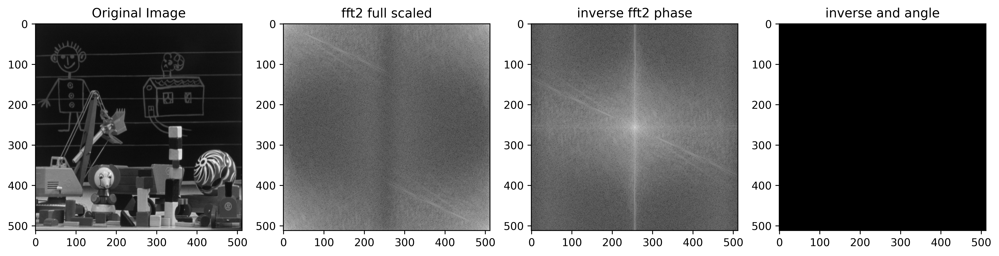

In [36]:
import cv2 
import numpy as np
import matplotlib.pyplot as plt


## i: Reading
img0 = plt.imread('toys.gif')

fig = plt.figure(figsize=(16, 10), dpi=512)
ax1, ax2, ax3, ax4 = fig.subplots(1, 4)

## original
ax1.imshow(img0, cmap='gray')
ax1.set_title('Original Image')

## ii: fft2
img1 = np.fft.fft2(np.float32(img0))
s1, s2 = img1.shape
ms = abs(img1) / (s1 * s2)

##############
## The log has been used to make them more visible, 
## you can remove them to see the orignial result 
##############

## plt image show may result in wrong image
## if you can't see the right image, please
## change the presentation method to what 
## cv2 provides
ax2.set_title('fft2 full scaled')
ax2.imshow(np.log(ms) , cmap='gray')
# cv2.imshow("fft2 full scaled", ms)
# cv2.waitKey()

fft2_1 = np.fft.fftshift(ms)
fft2_2 = abs(fft2_1) / (s1 * s2)
ax3.set_title('inverse fft2 phase')
ax3.imshow(np.log(fft2_2), cmap='gray')
# cv2.imshow("inverse fft2 phase ", fft2_2)
# cv2.waitKey()

## iii
i_fft_phase = np.exp(1j * np.angle(fft2_2))

I_phase = np.fft.fft2(i_fft_phase)
I_phase_min = min(abs(I_phase.flatten()))
I_phase_max = max(abs(I_phase.flatten()))

ax4.imshow(I_phase.astype("float32"), cmap='gray')
ax4.set_title('inverse and angle')



Problem 2

C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\2311333511.py:42: ComplexWarning: Casting complex values to real discards the imaginary part
  ax4.imshow(ifft.astype("uint8"), cmap='gray') ; ax4.set_title('Filtered Image')
C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\2311333511.py:53: ComplexWarning: Casting complex values to real discards the imaginary part
  ax7.imshow(ifft.astype("uint8"), cmap='gray') ; ax7.set_title('Filtered Image')
C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\2311333511.py:64: ComplexWarning: Casting complex values to real discards the imaginary part
  ax10.imshow(ifft.astype("uint8"), cmap='gray') ; ax10.set_title('Filtered Image')
C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\2311333511.py:75: ComplexWarning: Casting complex values to real discards the imaginary part
  ax13.imshow(ifft.astype("uint8"), cmap='gray') ; ax13.set_title('Filtered Image')


Text(0.5, 1.0, 'Filtered Image')

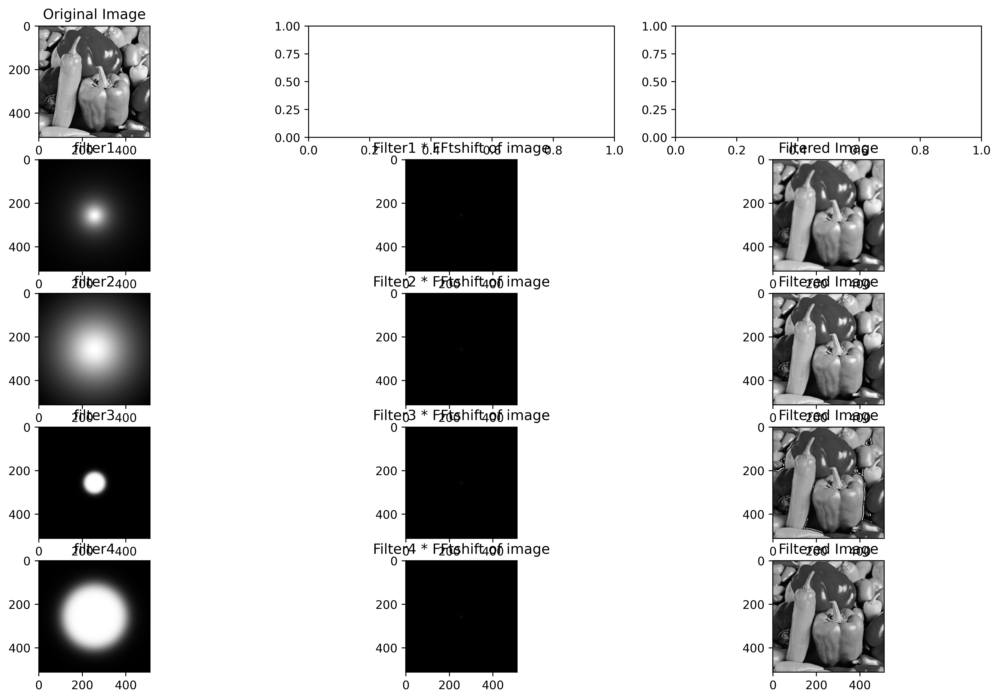

In [37]:
import cv2 
import numpy as np
import matplotlib.pyplot as plt


def butterworth(s1, s2, order, cutoff):
    r1 = s1 / 2
    r2 = s2 / 2
    h = np.ones((s1, s2))
    
    for i in range(s1):
        for j in range(s2):
            h[i][j] = 1 / (1 + (((((i-r1)**2) + ((j-r2)**2)) / ((cutoff)**2))**order))
   
    return h


## i: Reading
img2 = cv2.imread('pepper.jpg', cv2.IMREAD_GRAYSCALE)

fig = plt.figure(figsize=(16, 10), dpi=512)
(ax1, _, _), (ax2, ax3, ax4), (ax5, ax6, ax7), (ax8, ax9, ax10), (ax11, ax12, ax13) = fig.subplots(5, 3)
#  = fig.subplots(1, 3)

s1, s2 = img2.shape
s = s1 * s2
I_fft = np.fft.fft2(img2)
sh_fft_I = np.fft.fftshift(I_fft)

## original
ax1.imshow(img2, cmap='gray')
ax1.set_title('Original Image')

# h1
h1 = butterworth(s1, s2, 1, 50)
res1 = sh_fft_I * h1
i_sh_fft = np.fft.ifftshift(res1)
ifft = np.fft.ifft2(i_sh_fft)

ax2.imshow(h1, cmap='gray') ; ax2.set_title('filter1')
ax3.imshow(abs(res1) / s, cmap='gray') ; ax3.set_title('Filter1 * FFtshift of image')
ax4.imshow(ifft.astype("uint8"), cmap='gray') ; ax4.set_title('Filtered Image')


# h2
h2 = butterworth(s1, s2, 1, 150)
res2 = sh_fft_I * h2
i_sh_fft = np.fft.ifftshift(res2)
ifft = np.fft.ifft2(i_sh_fft)

ax5.imshow(h2, cmap='gray') ; ax5.set_title('filter2')
ax6.imshow(abs(res2) / s, cmap='gray') ; ax6.set_title('Filter2 * FFtshift of image')
ax7.imshow(ifft.astype("uint8"), cmap='gray') ; ax7.set_title('Filtered Image')


# h3
h3 = butterworth(s1, s2, 5, 50)
res3 = sh_fft_I * h3
i_sh_fft = np.fft.ifftshift(res3)
ifft = np.fft.ifft2(i_sh_fft)

ax8.imshow(h3, cmap='gray') ; ax8.set_title('filter3')
ax9.imshow(abs(res3) / s, cmap='gray') ; ax9.set_title('Filter3 * FFtshift of image')
ax10.imshow(ifft.astype("uint8"), cmap='gray') ; ax10.set_title('Filtered Image')


# h4
h4 = butterworth(s1, s2, 5, 150)
res4 = sh_fft_I * h4
i_sh_fft = np.fft.ifftshift(res4)
ifft = np.fft.ifft2(i_sh_fft)

ax11.imshow(h4, cmap='gray') ; ax11.set_title('filter4')
ax12.imshow(abs(res4) / s, cmap='gray') ; ax12.set_title('Filter4 * FFtshift of image')
ax13.imshow(ifft.astype("uint8"), cmap='gray') ; ax13.set_title('Filtered Image')



## descriptions: by adding the amount of cutoff, we encounter suppression in the ringing effect,
# because it contain a wider range of frequencies. at the other hand, by increasing the value of 
# order, the ringing effect increased, because the bigger order value, the more similarity the filter 
# would have with the ideal filter which has the most ringing effect.
# you can also see the chart in the root folder called I1.png


Problem 3

C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\1482178208.py:61: ComplexWarning: Casting complex values to real discards the imaginary part
  ax7.imshow(abs(Image.astype("uint8")), cmap='gray') ; ax7.set_title('filtered image')
C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\1482178208.py:66: ComplexWarning: Casting complex values to real discards the imaginary part
  a2 = Image.astype("uint8")


Text(0.5, 1.0, 'noise of the original image')

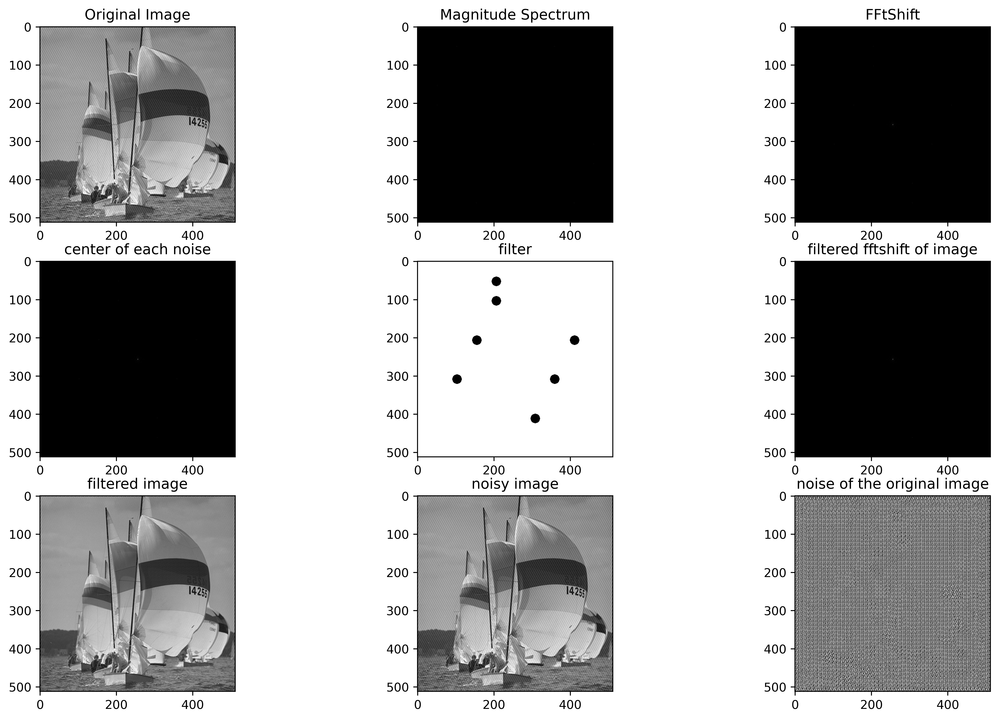

In [46]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


## i: Reading
img5 = plt.imread('prob2_s2012.gif')

fig = plt.figure(figsize=(16, 10), dpi=512)
(ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)  = fig.subplots(3, 3)


# original
ax1.imshow(img5, cmap='gray')
ax1.set_title('Original Image')

I_FFT = np.fft.fft2(img5)
s1, s2 = img5.shape
I_FFT_shift = np.fft.fftshift(I_FFT)


ax2.imshow(abs(I_FFT) / (s1 * s2), cmap='gray')
ax2.set_title('Magnitude Spectrum')
ax3.imshow(abs(I_FFT_shift) / (s1 * s2), cmap='gray')
ax3.set_title('FFtShift')

# it still has a problem if you want to watch them in the vscode
# but works great in cv2, uncomment the following lines to have them in cv2 view mode
# cv2.imshow("fft2 full scaled", abs(I_FFT) / (s1 * s2))
# cv2.imshow("fft2 full scaled", abs(I_FFT_shift) / (s1 * s2))
# cv2.waitKey()


###########
# description:
# image noise is the kind of periodic noise, because in the original image,
# it has periodic pattern that repeated.

########### C #############
ax4.imshow(abs(I_FFT_shift) / (s1 * s2), cmap='gray')
ax4.set_title('center of each noise')
noise_points = [[103, 308], [155, 206],
                [206, 103], [206, 52],
                [411, 206], [359, 308],
                [308, 411], [308, 564]]
radius = 150
h = np.ones((512, 512))

for i in range(512):
    for j in range(512):
        for num in range(8):
            if ((i - noise_points[num][1])**2) + ((j - noise_points[num][0]) ** 2) < radius:
                h[i][j] = 0
                
fft_h = I_FFT_shift * h
ifft_h = np.fft.ifftshift(fft_h)
Image = np.fft.ifft2(ifft_h)

ax5.imshow(h, cmap='gray') ; ax5.set_title('filter')
ax6.imshow(abs(fft_h) / (s1 * s2), cmap='gray') ; ax6.set_title('filtered fftshift of image')
ax7.imshow(abs(Image.astype("uint8")), cmap='gray') ; ax7.set_title('filtered image')
ax8.imshow(img5, cmap='gray') ; ax8.set_title('noisy image')


########### D #############
a2 = Image.astype("uint8")
noise_component = abs (img5 - a2)
ax9.imshow(noise_component, cmap='gray') ; ax9.set_title('noise of the original image')



Problem 4

C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\4051782786.py:58: ComplexWarning: Casting complex values to real discards the imaginary part
  ax7.imshow(abs(Image.astype("uint8")), cmap='gray') ; ax7.set_title('filtered image')
C:\Users\Hessam\AppData\Local\Temp\ipykernel_10448\4051782786.py:63: ComplexWarning: Casting complex values to real discards the imaginary part
  peaksnr1 = cv2.PSNR(Image.astype('uint8'), img7)


The peak-SNR value of filtered image is: 39.60269915787237


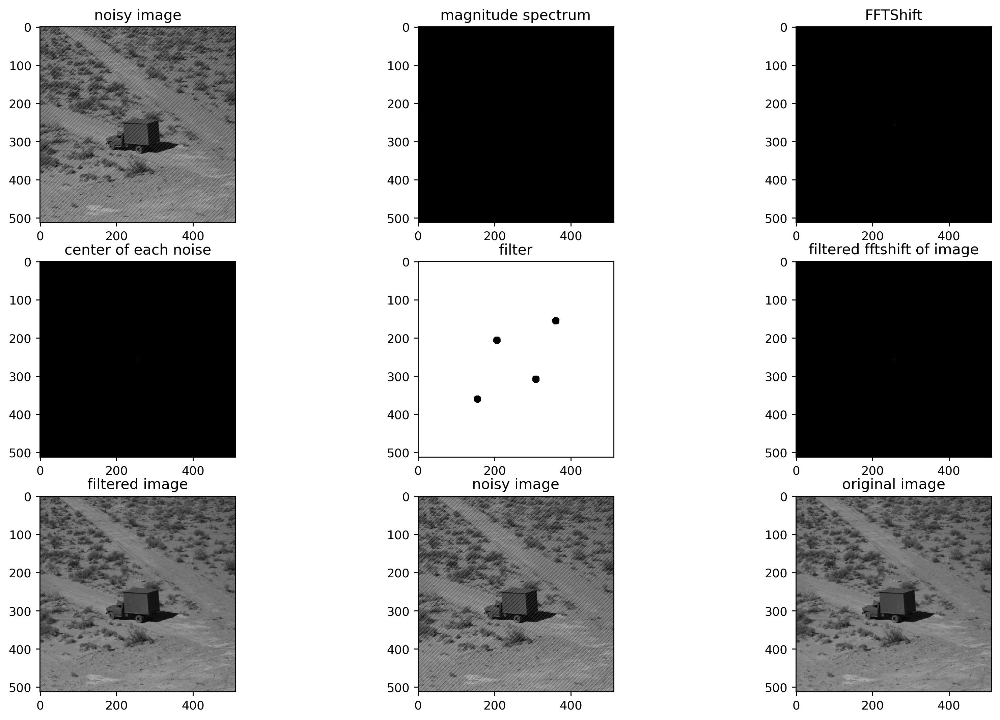

In [60]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


## a: Reading
img6 = plt.imread('trucknoise.gif')
img7 = plt.imread('Truck.gif')

fig = plt.figure(figsize=(16, 10), dpi=256)
(ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)  = fig.subplots(3, 3)
ax1.imshow(img6, cmap='gray') ; ax1.set_title('noisy image')

## b
I_FFT = np.fft.fft2(img6)
s1, s2 = img6.shape
I_FFT_shift = np.fft.fftshift(I_FFT)
ax2.imshow(abs(I_FFT) / (s1 * s2), cmap='gray') ; ax2.set_title('magnitude spectrum')
ax3.imshow(abs(I_FFT_shift) / (s1 * s2), cmap='gray') ; ax3.set_title('FFTShift')


## the old story with the vscode, if you cannot see the correct output (fully black image), use cv2
## it works great in cv2, uncomment the following lines to have them in cv2 view mode
# cv2.imsshow("fft2 full scaled", abs(I_FFT) / (s1 * s2))
# cv2.imshow("fft2 full scaled", abs(I_FFT_shift) / (s1 * s2))
# cv2.waitKey()

########################
# description:
# in this image, image noise is of the kind of periodic noise, because in the original image,
# it has periodic patterns that repeated throughout the image.


############################
########### C ##############
############################

ax4.imshow(abs(I_FFT_shift) / (s1 * s2), cmap='gray')
ax4.set_title('center of each noise')
noise_points = [[155, 360], [206, 206], 
                [360, 155], [308, 308]]

radius = 100
h = np.ones((512, 512))

for i in range(512):
    for j in range(512):
        for num in range(len(noise_points)):
            if ((i - noise_points[num][1])**2) + ((j - noise_points[num][0]) ** 2) < radius:
                h[i][j] = 0
                
fft_h = I_FFT_shift * h
ifft_h = np.fft.ifftshift(fft_h)
Image = np.fft.ifft2(ifft_h)

ax5.imshow(h, cmap='gray') ; ax5.set_title('filter')
ax6.imshow(abs(fft_h) / (s1 * s2), cmap='gray') ; ax6.set_title('filtered fftshift of image')
ax7.imshow(abs(Image.astype("uint8")), cmap='gray') ; ax7.set_title('filtered image')
ax8.imshow(img6, cmap='gray') ; ax8.set_title('noisy image')
ax9.imshow(img7, cmap='gray') ; ax9.set_title('original image')

######## D ##########
peaksnr1 = cv2.PSNR(Image.astype('uint8'), img7)
print('The peak-SNR value of filtered image is: {}'.format(peaksnr1))
